# **📷Final Project | Computer Vision 📷**
---

**Master's in Machine Learning for Health** | 2023-2024

Date: May 26th 2024

| Authors                   |       NIA         |
| ------                    |    ------         |
| Alexia Durán Vizcaíno     |       429771      |
| Antonio Sánchez Salgado   |       428745      |

Instructor: Iván González Díaz

---
<center><img src='https://c0.piktochart.com/v2/uploads/ff026532-700a-40da-a157-d9a9281918f2/3e0101f1dde2efcf0c3bc8a76fdd32cff2995805_original.png' width=400 /></center>

---


## *Object Detection with Ultralytics **YOLOv8***

We will use YOLOv8 from Ultralytics as an alternative to Faster-RCNN with ResNet-50.

In [20]:
import os
import cv2
import numpy as np
from PIL import Image, ImageDraw, ImageFont
import torch
from IPython.display import display, Image
import torchvision.transforms.functional as F
import matplotlib.pyplot as plt

### 1. Load the PASCAL VOC dataset 

The function to load the database is defined below. To simplify its treatment, the database is provided in the form of images (`images`) and masks for each of the object instances (`instances`). Thus, for each image there are as many masks as there are objects in it (with the segmentation of each one of them). Also, the category of each object is encoded in the name of the image. In addition, the `classes` semantic segmentation and the `masks` instance segmentation are provided.

In [1]:

class MyVOCDataset(object):
    def __init__(self, root, train):
        self.root = root
        self.train = train
        # Load all image files, sorting them to ensure that they are aligned
        if self.train:
            self.imgs = [os.path.join(root, name)
                         for root, dirs, files in os.walk(root)
                         for name in files if ('train' + os.path.sep + 'images' in root)
                         if name.lower().endswith(".jpg")]
        else:
            self.imgs = [os.path.join(root, name)
                         for root, dirs, files in os.walk(root)
                         for name in files if ('test' + os.path.sep + 'images' in root)
                         if name.lower().endswith(".jpg")]

    def __getitem__(self, idx):
        # Load images and masks
        img_path = self.imgs[idx]
        ImageFile.LOAD_TRUNCATED_IMAGES = True
        img = Image.open(img_path).convert("RGB")

        # Independent annotations for each object
        file = self.imgs[idx].split(os.path.sep)[-1]
        self.masks = [os.path.join(self.root, name)
                      for self.root, dirs, files in os.walk(self.imgs[idx].replace('images', 'instances').replace(file, ''))
                      for name in files
                      if name.startswith(file[:-4] + '_')]

        if not self.masks:
            masks = np.array(Image.new('L', img.size))
            labels = np.zeros((0,), dtype=np.int64)
            num_objs = 0
        else:
            mask = np.zeros((len(self.masks), img.size[1], img.size[0]), dtype=np.uint8)
            labels = np.zeros((len(self.masks),), dtype=np.int64)
            for j in range(len(self.masks)):
                mask[j, :, :] = np.array(Image.open(self.masks[j]))
                labels[j] = int(self.masks[j].split('_')[-1][:-4])
            num_objs = len(mask)
            masks = np.asarray(mask)

        boxes = []
        for i in range(num_objs):
            pos = np.where(masks[i])
            xmin = np.min(pos[1])
            xmax = np.max(pos[1])
            ymin = np.min(pos[0])
            ymax = np.max(pos[0])
            # Get aspect ratio
            W = xmax - xmin
            H = ymax - ymin
            if W == 0 or H == 0:
                labels = np.delete(labels, i)
            else:
                boxes.append([xmin, ymin, xmax, ymax])

        # Convert everything into a torch.Tensor
        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        num_objs = boxes.size(0)
        # Get the labels
        labels = torch.as_tensor(labels, dtype=torch.int64)
        image_id = torch.tensor([idx])
        # We need the area to filter the empty images
        if not boxes.size() == torch.Size([0]):
            area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        else:
            area = torch.tensor([0.])

        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["image_id"] = image_id
        target["area"] = area

        img = F.to_tensor(img)
        return img, target, img_path

    def __len__(self):
        return len(self.imgs)

In [ ]:
# Load the datasets
data_dir = "myVOC4"
train_dataset = MyVOCDataset(data_dir, train=True)
test_dataset = MyVOCDataset(data_dir, train=False)

# Define class names
class_names = ['background','bottle', 'chair', 'dining_table', 'sofa',]

### 2. Convert to appropiate YOLOv8 format 

The Ultralytics YOLO format is a dataset configuration format that allows you to define the dataset root directory, the relative paths to training/validation/testing image directories or *.txt files containing image paths, and a dictionary of class names.  
Labels for this format should be exported to YOLO format with one *.txt file per image. If there are no objects in an image, no *.txt file is required. The *.txt file should be formatted with one row per object in ``class x_center y_center width height`` format. Box coordinates must be in normalized xywh format (from 0 to 1). If your boxes are in pixels, you should divide ``x_center`` and ``width`` by image width, and ``y_center`` and ``height`` by image height. Class numbers should be zero-indexed (start with 0).

<img src="https://user-images.githubusercontent.com/26833433/91506361-c7965000-e886-11ea-8291-c72b98c25eec.jpg" width="70%">

In [2]:
def convert_voc_to_yolo(dataset, labels_dir):
    # Check if the directory for YOLO labels exists, if not, create it
    if not os.path.exists(labels_dir):
        os.makedirs(labels_dir)

    # Iterate over each item in the dataset
    for idx in range(len(dataset)):
        # Extract image, target (annotations), and image path from the dataset
        img, target, img_path = dataset[idx]
        
        # Get the height and width of the image
        image_height, image_width = img.shape[1], img.shape[2]
        
        # Construct the path for the label file by changing the image file extension to .txt
        label_file = os.path.join(labels_dir, os.path.splitext(os.path.basename(img_path))[0] + '.txt')
        
        # Open the label file in write mode
        with open(label_file, 'w') as f:
            # Iterate over each bounding box in the target annotations
            for i in range(target['boxes'].shape[0]):
                # Get the bounding box coordinates
                xmin, ymin, xmax, ymax = target['boxes'][i]
                
                # Get the class id of the object in the bounding box
                class_id = target['labels'][i].item()
                
                # Calculate the center coordinates, width, and height of the bounding box in YOLO format
                x_center = ((xmin + xmax) / 2) / image_width
                y_center = ((ymin + ymax) / 2) / image_height
                width = (xmax - xmin) / image_width
                height = (ymax - ymin) / image_height
                
                # Write the class id and bounding box in YOLO format to the label file
                f.write(f'{class_id} {x_center} {y_center} {width} {height}\n')

In [ ]:
# Convert datasets to YOLO format
convert_voc_to_yolo(train_dataset, './myVOC4_yolov8/train/labels', class_names)
convert_voc_to_yolo(test_dataset, './myVOC4_yolov8/test/labels', class_names)

In [3]:
train_images_path = './myVOC4_yolov8/train/images'
test_images_path = './myVOC4_yolov8/test/images'

print('Train Images Path Exists:', os.path.exists(train_images_path))
print('Test Images Path Exists:', os.path.exists(test_images_path))
print('Train Images Directory Content Count:', len(os.listdir(train_images_path)))
print('Test Images Directory Content Count:', len(os.listdir(test_images_path)))


Train Images Path Exists: True
Test Images Path Exists: True
Train Images Directory Content Count: 234
Test Images Directory Content Count: 68


### 3. Fine-tuning YOLOv8

Now, we use a pre-trained model of YOLOv8 for object detection and we finetune it in our specific dataset. We first need to create the ``yolov8_config.yalm`` file which contains the paths for the training and test partitions, and the information related to the number of classes that it needs to detect. Furthermore, we can define some other params of the model, such as the predefined image size (``imgsz=640``)`or the optimizer (``optimizer='SGD'``).

In [4]:
from ultralytics import YOLO

# Load the pre-trained YOLOv8 model configuration
model = YOLO('yolov8l.pt')

# Train the model using the configuration file
model.train(data='yolov8_config.yaml', epochs=50, batch=18, imgsz=640, device=[1,2,3], name="SGDe50", optimizer='SGD')

New https://pypi.org/project/ultralytics/8.2.21 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.2.20 🚀 Python-3.11.5 torch-2.1.2 CUDA:1 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
                                                     CUDA:2 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
                                                     CUDA:3 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
engine/trainer: task=detect, mode=train, model=yolov8l.pt, data=yolov8_config.yaml, epochs=50, time=None, patience=100, batch=18, imgsz=640, save=True, save_period=-1, cache=False, device=[1, 2, 3], workers=8, project=None, name=SGDe50, exist_ok=False, pretrained=True, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det

*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************


Ultralytics YOLOv8.2.20 🚀 Python-3.11.5 torch-2.1.2 CUDA:1 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
                                                     CUDA:2 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
                                                     CUDA:3 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
TensorBoard: Start with 'tensorboard --logdir runs/detect/SGDe50', view at http://localhost:6006/
Overriding model.yaml nc=80 with nc=5
Transferred 589/595 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks with YOLOv8n...
AMP: checks passed ✅


train: Scanning /export/gts_usuarios/assalgado/CV/myVOC4_yolov8/train/labels.cache... 234 images, 101 backgrounds, 0 corrupt: 100%|██████████| 234/234 [00:00<?, ?it/s]
val: Scanning /export/gts_usuarios/assalgado/CV/myVOC4_yolov8/test/labels.cache... 68 images, 10 backgrounds, 0 corrupt: 100%|██████████| 68/68 [00:00<?, ?it/s]


Plotting labels to runs/detect/SGDe50/labels.jpg... 
optimizer: SGD(lr=0.01, momentum=0.937) with parameter groups 97 weight(decay=0.0), 104 weight(decay=0.0005625000000000001), 103 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 24 dataloader workers
Logging results to runs/detect/SGDe50
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      5.29G     0.9218      12.44      1.237         19        640: 100%|██████████| 13/13 [00:08<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.85it/s]


                   all         68        130      0.504      0.287      0.355      0.283

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      4.77G     0.9486      2.533      1.249         11        640: 100%|██████████| 13/13 [00:06<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.78it/s]


                   all         68        130      0.789      0.789      0.826      0.652

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      4.96G     0.7936      1.448      1.143         10        640: 100%|██████████| 13/13 [00:06<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.78it/s]


                   all         68        130      0.842      0.703      0.806       0.65

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      4.92G     0.7864      1.317      1.224         30        640: 100%|██████████| 13/13 [00:06<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.77it/s]


                   all         68        130      0.716      0.745      0.752      0.606

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      4.87G     0.6814      1.063      1.094         22        640: 100%|██████████| 13/13 [00:06<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.84it/s]


                   all         68        130      0.745      0.732      0.746      0.586

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      4.93G     0.7449      1.058      1.113         16        640: 100%|██████████| 13/13 [00:06<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.98it/s]


                   all         68        130      0.734      0.676       0.74      0.573

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      5.02G     0.7047      1.076      1.098         17        640: 100%|██████████| 13/13 [00:05<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.81it/s]


                   all         68        130      0.644       0.58      0.619      0.466

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      4.78G     0.7302      1.241      1.115         23        640: 100%|██████████| 13/13 [00:05<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.87it/s]


                   all         68        130      0.589        0.5      0.496      0.344

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      4.96G     0.8296       1.29      1.158         11        640: 100%|██████████| 13/13 [00:06<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.81it/s]


                   all         68        130      0.585      0.454       0.45      0.303

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      4.85G     0.8395      1.181      1.166         15        640: 100%|██████████| 13/13 [00:05<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.93it/s]


                   all         68        130      0.508      0.329      0.333      0.228

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      4.93G     0.8396      1.337      1.188          3        640: 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.78it/s]


                   all         68        130      0.332      0.382      0.297      0.195

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      4.93G     0.8842      1.511      1.239         23        640: 100%|██████████| 13/13 [00:05<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.75it/s]


                   all         68        130      0.398       0.43      0.398      0.261

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      4.97G     0.7853      1.136      1.131         23        640: 100%|██████████| 13/13 [00:05<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.84it/s]


                   all         68        130      0.489        0.4       0.42       0.27

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      4.78G     0.7577      1.429       1.18          5        640: 100%|██████████| 13/13 [00:05<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.65it/s]


                   all         68        130      0.389      0.399      0.339       0.21

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      4.92G     0.8725      1.175       1.18         20        640: 100%|██████████| 13/13 [00:06<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.79it/s]


                   all         68        130      0.492      0.361       0.38      0.256

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      4.93G     0.8293      1.227      1.268         11        640: 100%|██████████| 13/13 [00:05<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.79it/s]


                   all         68        130      0.657      0.327      0.387      0.237

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      4.93G     0.8095      1.215      1.187         22        640: 100%|██████████| 13/13 [00:05<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.78it/s]


                   all         68        130      0.544       0.33      0.363      0.229

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      4.87G     0.8082      1.193      1.232          9        640: 100%|██████████| 13/13 [00:05<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.09it/s]


                   all         68        130       0.55      0.404       0.41      0.247

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      4.93G     0.8232     0.9792      1.142         13        640: 100%|██████████| 13/13 [00:05<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.01it/s]


                   all         68        130       0.56        0.4      0.429       0.29

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      4.93G     0.6553     0.8314      1.055         18        640: 100%|██████████| 13/13 [00:05<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.79it/s]


                   all         68        130      0.659      0.361      0.436       0.29

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      4.97G      0.823      1.104      1.223         16        640: 100%|██████████| 13/13 [00:05<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.76it/s]


                   all         68        130       0.76      0.362      0.447      0.274

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      4.78G     0.7594      1.017      1.189         14        640: 100%|██████████| 13/13 [00:05<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.79it/s]


                   all         68        130      0.754      0.371      0.448      0.291

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      4.93G     0.7473     0.8756      1.115         24        640: 100%|██████████| 13/13 [00:06<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.72it/s]


                   all         68        130      0.656      0.434      0.449      0.291

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      5.02G     0.8244     0.9496      1.148         15        640: 100%|██████████| 13/13 [00:06<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.74it/s]


                   all         68        130      0.655      0.401      0.448      0.279

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      4.97G     0.6527      0.815      1.084          6        640: 100%|██████████| 13/13 [00:05<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.75it/s]


                   all         68        130      0.552      0.443      0.408      0.245

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      4.77G     0.8047     0.9427      1.119         25        640: 100%|██████████| 13/13 [00:05<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.81it/s]


                   all         68        130      0.609      0.407      0.439      0.299

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      4.93G     0.6989     0.8894      1.088         25        640: 100%|██████████| 13/13 [00:06<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.67it/s]


                   all         68        130      0.511      0.417      0.388      0.261

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      4.97G     0.7268     0.8457      1.056         23        640: 100%|██████████| 13/13 [00:05<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.90it/s]


                   all         68        130      0.493      0.409      0.407      0.274

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      5.02G     0.7471     0.8878      1.146          8        640: 100%|██████████| 13/13 [00:05<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.72it/s]


                   all         68        130      0.631      0.361      0.415      0.271

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      4.77G     0.6472     0.7841      1.085         12        640: 100%|██████████| 13/13 [00:05<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.76it/s]


                   all         68        130      0.638      0.365      0.394      0.261

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      4.92G     0.6974     0.8605      1.144         10        640: 100%|██████████| 13/13 [00:06<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.82it/s]


                   all         68        130      0.518      0.412      0.437      0.289

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      4.93G     0.6769     0.8029      1.138          9        640: 100%|██████████| 13/13 [00:05<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.73it/s]


                   all         68        130      0.669      0.369      0.436      0.286

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      4.93G     0.6148     0.6418       1.04         18        640: 100%|██████████| 13/13 [00:05<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.77it/s]


                   all         68        130      0.673      0.362      0.442      0.285

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      4.81G     0.6459     0.7098      1.071          9        640: 100%|██████████| 13/13 [00:05<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.75it/s]


                   all         68        130      0.558      0.431       0.46      0.315

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      4.93G     0.6092     0.7205       1.06         17        640: 100%|██████████| 13/13 [00:06<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.85it/s]


                   all         68        130      0.611        0.4      0.458       0.33

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      4.97G      0.606     0.7202      1.054         23        640: 100%|██████████| 13/13 [00:05<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.71it/s]


                   all         68        130      0.785      0.392      0.491      0.369

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      4.97G     0.5961     0.6379      1.026         13        640: 100%|██████████| 13/13 [00:06<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.78it/s]


                   all         68        130      0.699      0.428      0.477      0.347

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      4.87G      0.601     0.6608      1.035         21        640: 100%|██████████| 13/13 [00:05<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.85it/s]


                   all         68        130      0.758      0.383      0.468      0.344

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      4.93G     0.7463      1.023     0.9926          8        640: 100%|██████████| 13/13 [00:06<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.77it/s]


                   all         68        130      0.848      0.355      0.436      0.343

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      4.97G     0.6674     0.7352      1.114         25        640: 100%|██████████| 13/13 [00:05<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.81it/s]


                   all         68        130       0.67        0.4      0.452      0.342
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      4.93G     0.4806     0.5189     0.9525          3        640: 100%|██████████| 13/13 [00:06<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.83it/s]


                   all         68        130      0.701      0.414      0.472      0.347

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      4.77G     0.5346     0.4606      1.045          4        640: 100%|██████████| 13/13 [00:05<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.82it/s]


                   all         68        130      0.656      0.421      0.474      0.362

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      4.93G     0.3918     0.4004     0.8903          3        640: 100%|██████████| 13/13 [00:05<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.76it/s]


                   all         68        130      0.654      0.415      0.476      0.352

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      4.92G     0.4539      0.456     0.9411          3        640: 100%|██████████| 13/13 [00:05<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.77it/s]


                   all         68        130      0.713      0.437      0.485      0.355

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      4.97G     0.4376     0.4313     0.9084          1        640: 100%|██████████| 13/13 [00:05<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.72it/s]


                   all         68        130      0.757      0.388      0.486      0.366

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      4.78G     0.4001     0.3448     0.8782          6        640: 100%|██████████| 13/13 [00:06<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.86it/s]


                   all         68        130      0.759      0.388      0.498      0.367

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      4.96G     0.4799     0.4832     0.9261         13        640: 100%|██████████| 13/13 [00:05<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.75it/s]


                   all         68        130      0.764      0.403        0.5      0.369

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      4.93G     0.4109     0.3906     0.9055          3        640: 100%|██████████| 13/13 [00:05<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.03it/s]


                   all         68        130      0.721      0.408      0.487      0.363

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      4.97G     0.3679     0.3359      0.901         10        640: 100%|██████████| 13/13 [00:05<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.80it/s]


                   all         68        130      0.709      0.409      0.481      0.362

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      4.81G       0.44     0.3769     0.8887          2        640: 100%|██████████| 13/13 [00:05<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.78it/s]


                   all         68        130      0.703      0.403      0.482      0.361

50 epochs completed in 0.162 hours.
Optimizer stripped from runs/detect/SGDe50/weights/last.pt, 87.6MB
Optimizer stripped from runs/detect/SGDe50/weights/best.pt, 87.6MB

Validating runs/detect/SGDe50/weights/best.pt...
Ultralytics YOLOv8.2.20 🚀 Python-3.11.5 torch-2.1.2 CUDA:1 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
                                                     CUDA:2 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
                                                     CUDA:3 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
Model summary (fused): 268 layers, 43610463 parameters, 0 gradients, 164.8 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.77it/s]


                   all         68        130      0.789      0.789      0.825      0.653
                bottle         68         36      0.928      0.712      0.805      0.533
                 chair         68         52      0.686      0.827      0.814      0.609
          dining_table         68         15      0.621      0.766      0.716      0.563
                  sofa         68         27      0.922      0.852      0.966      0.907
Speed: 0.1ms preprocess, 17.2ms inference, 0.0ms loss, 4.5ms postprocess per image
Results saved to runs/detect/SGDe50


### 4. Evaluate the model

In [5]:
# Evaluate the model in our test dataset
metrics = model.val()
print(metrics)
model_path = "./runs/detect/SGDe50/"

Ultralytics YOLOv8.2.20 🚀 Python-3.11.5 torch-2.1.2 CUDA:1 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
                                                     CUDA:2 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
                                                     CUDA:3 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
Model summary (fused): 268 layers, 43610463 parameters, 0 gradients, 164.8 GFLOPs


val: Scanning /export/gts_usuarios/assalgado/CV/myVOC4_yolov8/test/labels.cache... 68 images, 10 backgrounds, 0 corrupt: 100%|██████████| 68/68 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.14s/it]


                   all         68        130      0.798      0.779      0.822      0.648
                bottle         68         36      0.927      0.704      0.808      0.534
                 chair         68         52      0.708      0.827      0.815      0.609
          dining_table         68         15      0.638      0.733      0.702      0.553
                  sofa         68         27      0.921      0.852      0.964      0.895
Speed: 1.3ms preprocess, 23.4ms inference, 0.0ms loss, 25.6ms postprocess per image
Results saved to runs/detect/SGDe502
ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7fb96121af50>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005

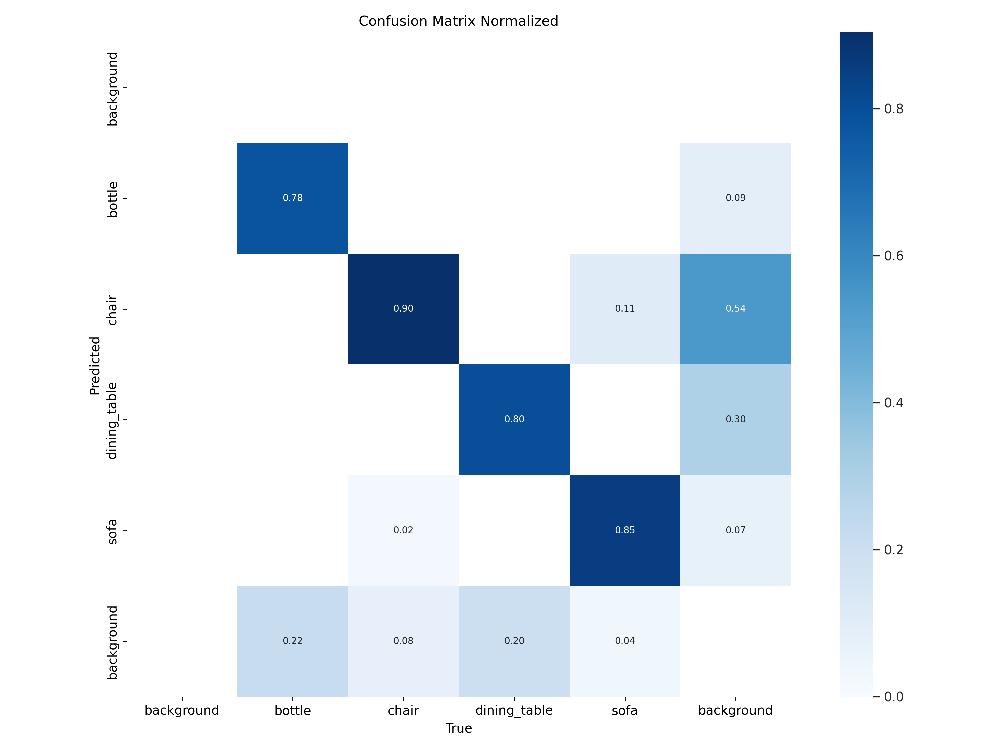

In [41]:
Image(filename = model_path +'confusion_matrix_normalized.png', width=800)

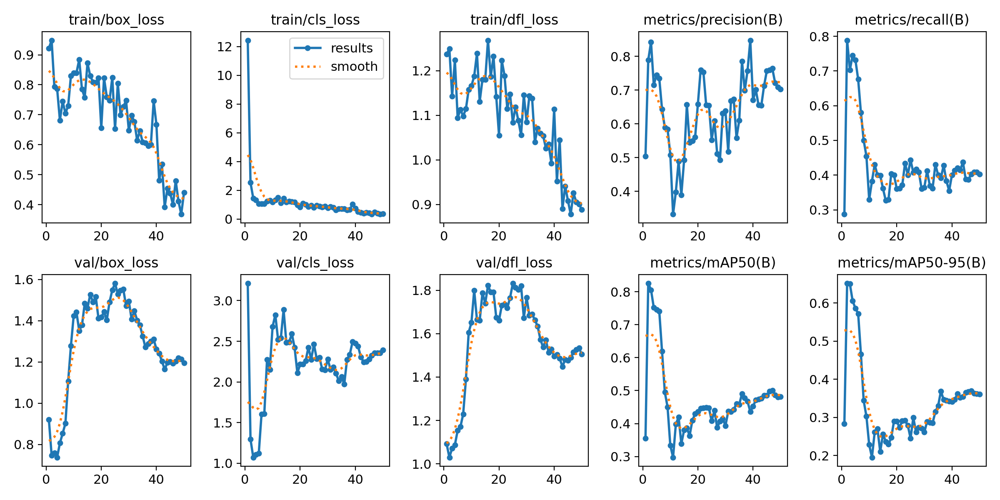

In [42]:
Image(filename = model_path +'results.png', width=800)

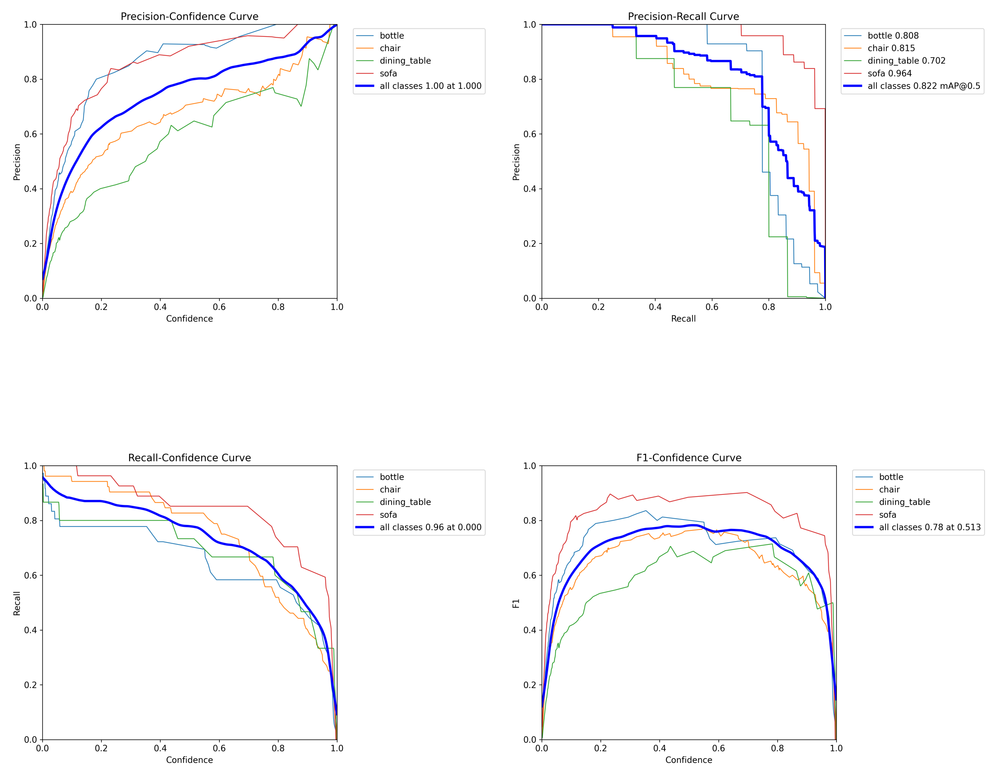

In [43]:
# Define the paths to your images
image_paths = [
    model_path + 'P_curve.png',
    model_path + 'PR_curve.png',
    model_path + 'R_curve.png',
    model_path + 'F1_curve.png'
]

# Set up the figure and axes
fig, axs = plt.subplots(2, 2, figsize=(30, 30))

# Remove axes for a cleaner look
for ax in axs.flatten():
    ax.axis('off')

# Display each image in a 2x2 grid
for ax, img_path in zip(axs.flatten(), image_paths):
    img = plt.imread(img_path)
    ax.imshow(img)

# Display the plot
plt.tight_layout()
plt.show()


### 5. Save the results

In [44]:
from ultralytics import YOLO

# Load the YOLOv8 model configuration
best_model = model_path + "weights/best.pt"
model = YOLO(best_model)

# Train the model using the configuration file
model.predict(source="./myVOC4/test/images", conf=0.25, save=True)


image 1/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_000573.jpg: 448x640 1 chair, 1 dining_table, 46.3ms
image 2/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_000589.jpg: 448x640 4 sofas, 30.1ms
image 3/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_000731.jpg: 640x512 1 chair, 29.3ms
image 4/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_000795.jpg: 448x640 1 bottle, 29.1ms
image 5/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_002521.jpg: 480x640 1 chair, 1 dining_table, 29.1ms
image 6/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_002864.jpg: 480x640 4 bottles, 2 dining_tables, 27.7ms
image 7/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_004339.jpg: 448x640 (no detections), 29.2ms
image 8/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_004659.jpg: 640x544 1 bottle, 29.1ms
image 9/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_005399.jpg: 640x544 8 bottles

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'background', 1: 'bottle', 2: 'chair', 3: 'dining_table', 4: 'sofa'}
 obb: None
 orig_img: array([[[ 25,  59,  88],
         [ 42,  58,  87],
         [ 73,  88, 114],
         ...,
         [ 74, 111, 169],
         [ 74, 111, 167],
         [ 73, 110, 166]],
 
        [[ 14,  45,  76],
         [ 51,  62,  94],
         [ 70,  83, 109],
         ...,
         [ 72, 114, 173],
         [ 73, 115, 174],
         [ 74, 117, 174]],
 
        [[  6,  40,  70],
         [ 43,  58,  90],
         [ 67,  82, 108],
         ...,
         [ 79, 123, 184],
         [ 80, 124, 185],
         [ 80, 124, 185]],
 
        ...,
 
        [[ 41,  45,  56],
         [ 42,  46,  57],
         [ 42,  47,  56],
         ...,
         [  1,   4,   8],
         [  1,   4,   8],
         [  0,   3,   7]],
 
        [[ 40,  43,  57],
         [ 41,  44,  58],

### 6. Visualize the results
After using the model to predict over the test dataset, we can find all the images in ``./runs/detect/predict``.   
Below, we print a combination of these test images.

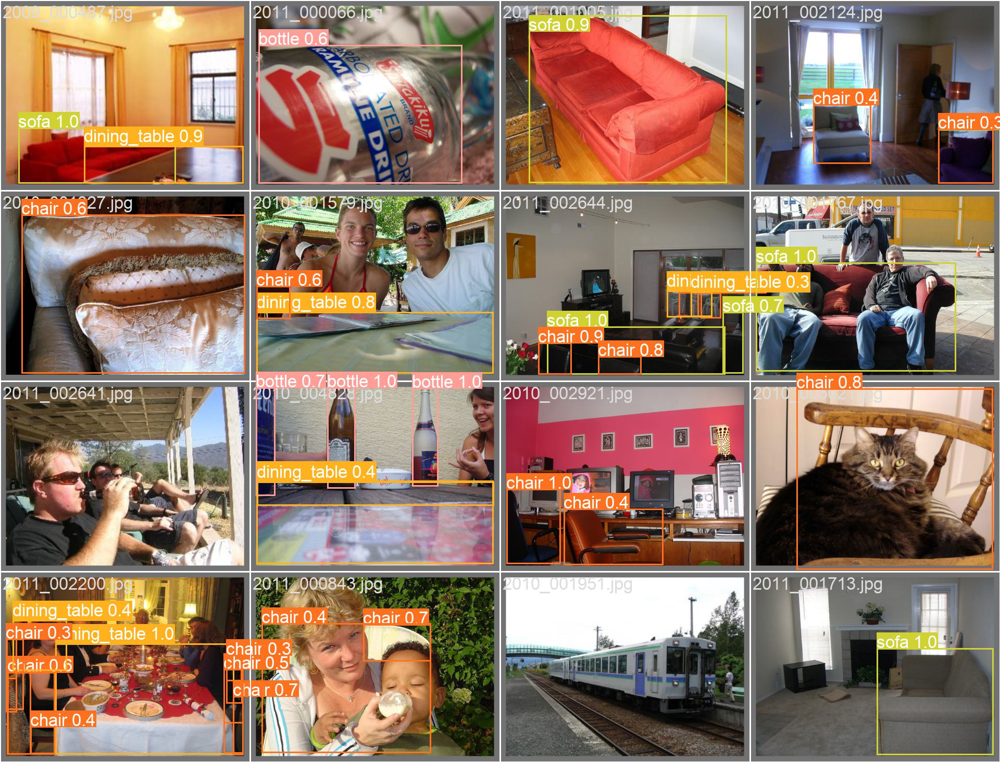

In [46]:
Image(filename = model_path + 'val_batch1_pred.jpg', width=1000)

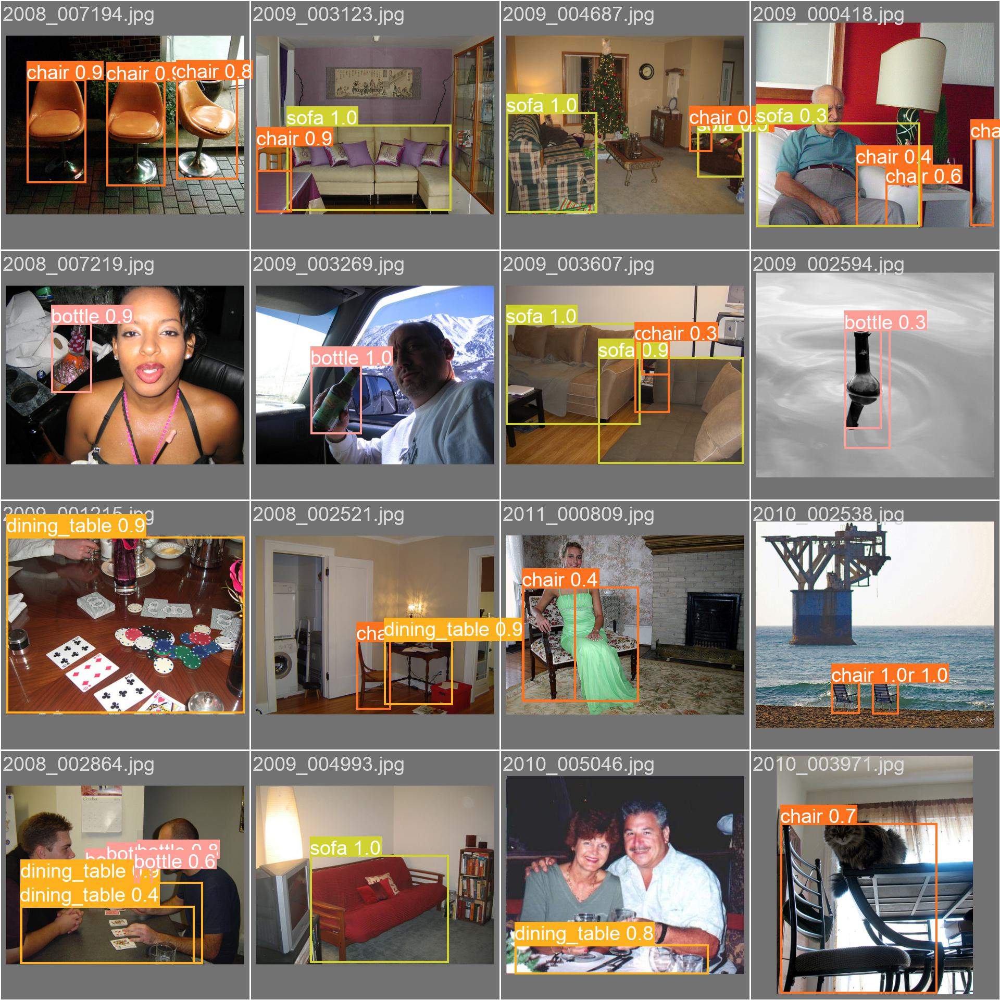

In [47]:
Image(filename = model_path + 'val_batch2_pred.jpg', width=1000)

### 7. Inference with "micasa images"

Finally, we wanted to experiment if our model was able to detect the objects with other unseen pictures. For this purposes, we have made some home-made photos in order to test our resulting model. Here, we show the results.

In [16]:
from ultralytics import YOLO

# Load the YOLOv8 model configuration
model_path = "./runs/detect/SGDe50/weights/best.pt"
model = YOLO(model_path)  

# Train the model using the configuration file
model.predict(source="./micasa_img", conf=0.25, save=True)


image 1/3 /export/gts_usuarios/assalgado/CV/micasa_img/IMG_6156.jpg: 480x640 2 bottles, 1 chair, 1 dining_table, 2 sofas, 132.4ms
image 2/3 /export/gts_usuarios/assalgado/CV/micasa_img/IMG_6157.jpg: 480x640 2 bottles, 1 chair, 2 sofas, 20.1ms
image 3/3 /export/gts_usuarios/assalgado/CV/micasa_img/IMG_6158.jpg: 640x480 2 bottles, 3 chairs, 1 dining_table, 1 sofa, 123.7ms
Speed: 4.3ms preprocess, 92.1ms inference, 233.7ms postprocess per image at shape (1, 3, 640, 480)
Results saved to runs/detect/predict2


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'background', 1: 'bottle', 2: 'chair', 3: 'dining_table', 4: 'sofa'}
 obb: None
 orig_img: array([[[142, 173, 198],
         [139, 170, 195],
         [143, 174, 199],
         ...,
         [154, 180, 192],
         [154, 180, 192],
         [154, 180, 192]],
 
        [[148, 179, 204],
         [148, 179, 204],
         [142, 173, 198],
         ...,
         [157, 183, 195],
         [157, 183, 195],
         [152, 178, 190]],
 
        [[142, 173, 198],
         [146, 177, 202],
         [137, 168, 193],
         ...,
         [150, 176, 188],
         [150, 176, 188],
         [149, 175, 187]],
 
        ...,
 
        [[ 26,  44,  61],
         [ 15,  33,  50],
         [ 13,  31,  48],
         ...,
         [110, 136, 148],
         [114, 140, 152],
         [116, 142, 154]],
 
        [[ 13,  31,  48],
         [  6,  24,  41],

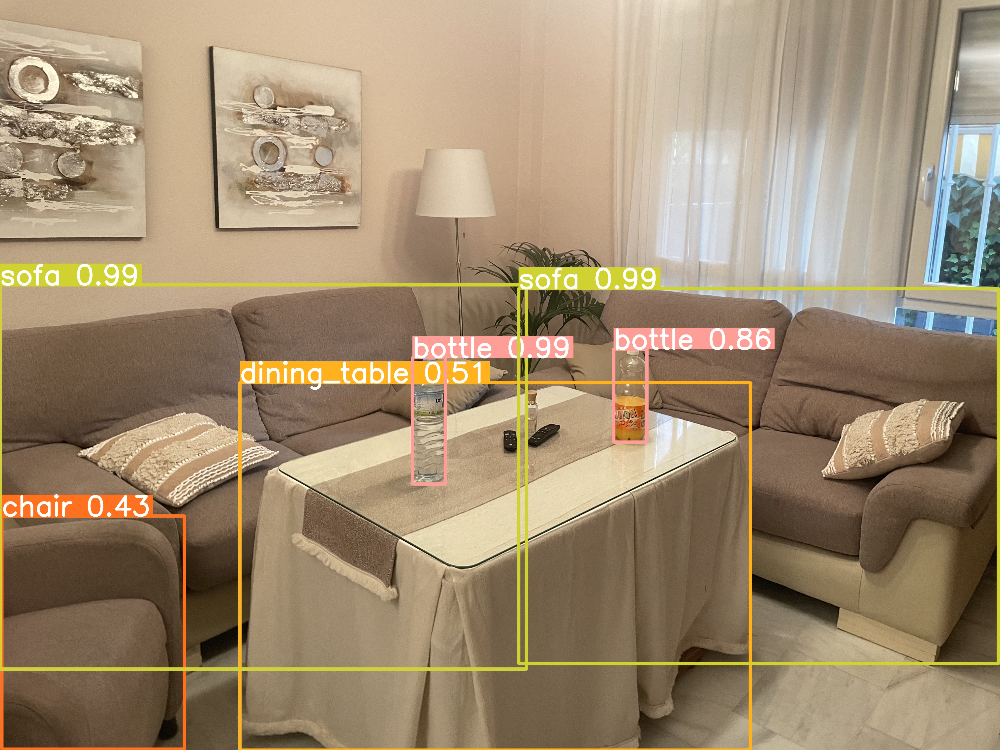

In [53]:
Image(filename='./runs/detect/micasa_predict/IMG_6156.jpg', width=500)

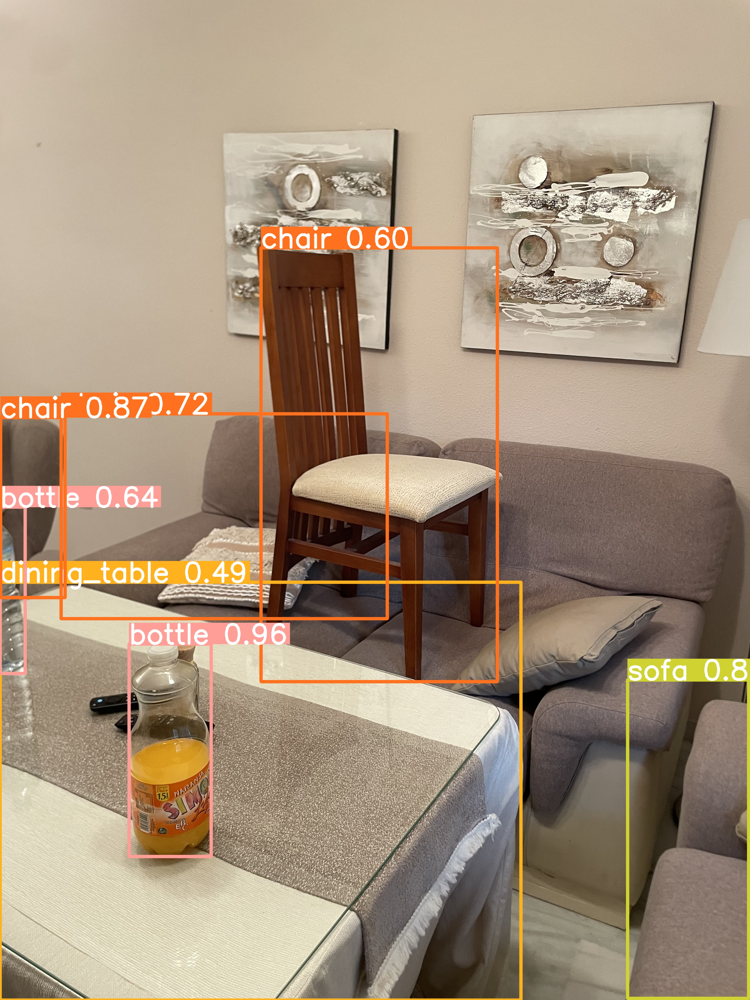

In [54]:
Image(filename='./runs/detect/micasa_predict/IMG_6158.jpg', width=500)

## *Semantic Segmentation with Ultralytics **YOLOv8***

### 1. Create polygon from masks

In the PASCAL VOC dataset, we have for every objected detected a mask of the object and the class in a ``instance`` image. Similarly to the preparation of the dataset in the object detection task, we now need to get this mask images into ``labels.txt`` to input our model. In this case, we need a unique .txt file per image, in which each object information is in a different row. Then, each row must have the object ``class``, a number representing the class of the object, and the ``polygon``, the bounding coordinates around the mask area, normalized to be between 0 and 1. 

In [23]:
def mask_to_polygons(input_dir, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
        
    polygons_dict = {}

    for j in os.listdir(input_dir):
        image_path = os.path.join(input_dir, j)
        # Extract the base image name and class id from the file name
        base_name = "_".join(j.split('_')[:-2])
        class_id = j.split('_')[-1].split('.')[0]
        
        # load the binary mask and get its contours
        mask = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        _, mask = cv2.threshold(mask, 1, 255, cv2.THRESH_BINARY)

        H, W = mask.shape
        contours, hierarchy = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # convert the contours to polygons
        if base_name not in polygons_dict:
            polygons_dict[base_name] = []

        for cnt in contours:
            if cv2.contourArea(cnt) > 200:
                polygon = [class_id]
                for point in cnt:
                    x, y = point[0]
                    polygon.append(x / W)
                    polygon.append(y / H)
                polygons_dict[base_name].append(polygon)

    # Write the polygons to .txt files
    for base_name, polygons in polygons_dict.items():
        with open('{}.txt'.format(os.path.join(output_dir, base_name)), 'w') as f:
            for polygon in polygons:
                for p_, p in enumerate(polygon):
                    if p_ == 0:
                        f.write('{} '.format(p))
                    elif p_ == len(polygon) - 1:
                        f.write('{}\n'.format(p))
                    else:
                        f.write('{} '.format(p))
            f.close()


In [24]:
# Define class names
class_names = ['background','bottle', 'chair', 'dining_table', 'sofa',]


# Convert datasets to YOLO format
mask_to_polygons('./myVOC4/train/instances', './myVOC4_yolov8-segmentation/train/labels')
mask_to_polygons('./myVOC4/test/instances', './myVOC4_yolov8-segmentation/test/labels')


### 2. Fine-tuning YOLOv8-seg

In [26]:
from ultralytics import YOLO

# Load the YOLOv8 model for segmentation
model = YOLO('yolov8l-seg.pt')

# Train the model using the configuration file
model.train(data='yolov8_segmentation.yaml', epochs=50, batch=18, imgsz=640, device=[1,2,3], name="seg-SGDe50", optimizer='SGD')


New https://pypi.org/project/ultralytics/8.2.22 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.2.20 🚀 Python-3.11.5 torch-2.1.2 CUDA:1 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
                                                     CUDA:2 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
                                                     CUDA:3 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
engine/trainer: task=segment, mode=train, model=yolov8l-seg.pt, data=yolov8_segmentation.yaml, epochs=50, time=None, patience=100, batch=18, imgsz=640, save=True, save_period=-1, cache=False, device=[1, 2, 3], workers=8, project=None, name=seg-SGDe502, exist_ok=False, pretrained=True, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, 

*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************


Ultralytics YOLOv8.2.20 🚀 Python-3.11.5 torch-2.1.2 CUDA:1 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
                                                     CUDA:2 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
                                                     CUDA:3 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
TensorBoard: Start with 'tensorboard --logdir runs/segment/seg-SGDe502', view at http://localhost:6006/
Overriding model.yaml nc=80 with nc=5
Transferred 651/657 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks with YOLOv8n...
AMP: checks passed ✅


train: Scanning /export/gts_usuarios/assalgado/CV/myVOC4_yolov8-segmentation/train/labels... 133 images, 102 backgrounds, 0 corrupt: 100%|██████████| 234/234 [00:02<00:00, 91.39it/s]


train: New cache created: /export/gts_usuarios/assalgado/CV/myVOC4_yolov8-segmentation/train/labels.cache


val: Scanning /export/gts_usuarios/assalgado/CV/myVOC4_yolov8-segmentation/test/labels... 58 images, 10 backgrounds, 0 corrupt: 100%|██████████| 68/68 [00:00<00:00, 236.26it/s]


val: New cache created: /export/gts_usuarios/assalgado/CV/myVOC4_yolov8-segmentation/test/labels.cache
Plotting labels to runs/segment/seg-SGDe502/labels.jpg... 
optimizer: SGD(lr=0.01, momentum=0.937) with parameter groups 106 weight(decay=0.0), 117 weight(decay=0.0005625000000000001), 116 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 24 dataloader workers
Logging results to runs/segment/seg-SGDe502
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/50      6.35G      1.094      2.697      12.69      1.198         40        640: 100%|██████████| 13/13 [00:10<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.21it/s]


                   all         68        154      0.343      0.249      0.237      0.167      0.337      0.237      0.223      0.131

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/50         6G      1.041      2.283      2.644       1.25         25        640: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.41it/s]


                   all         68        154      0.716      0.582      0.645       0.52      0.666      0.588      0.623      0.432

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/50      6.07G     0.8331       1.98      1.872      1.093         17        640: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.48it/s]


                   all         68        154      0.679      0.712      0.702      0.568      0.669      0.701      0.683      0.476

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/50      5.97G     0.7704      1.722      1.631      1.073         39        640: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.59it/s]


                   all         68        154      0.669      0.593      0.627      0.495      0.639      0.564      0.604      0.416

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/50      6.08G     0.6673      1.226      1.192      1.009         24        640: 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.51it/s]


                   all         68        154      0.749      0.522      0.643      0.529      0.756      0.506      0.627      0.446

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/50      5.84G      0.726      1.489      1.288      1.023         19        640: 100%|██████████| 13/13 [00:07<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.51it/s]


                   all         68        154      0.628      0.615       0.62      0.494      0.619      0.607      0.605      0.441

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/50      5.83G     0.6867      1.335      1.191      1.016         20        640: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.45it/s]


                   all         68        154      0.636      0.534      0.582       0.45      0.616       0.52      0.552      0.377

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/50      6.08G     0.6958      1.354      1.339      1.027         21        640: 100%|██████████| 13/13 [00:07<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.52it/s]


                   all         68        154       0.66      0.462      0.512      0.403      0.636       0.44      0.499      0.338

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/50      6.01G     0.8065      1.524      1.192       1.07         13        640: 100%|██████████| 13/13 [00:07<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.47it/s]


                   all         68        154      0.599      0.428      0.482      0.352      0.592      0.416      0.449      0.266

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/50      6.01G     0.7596       1.34      1.103       1.01         21        640: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.48it/s]


                   all         68        154      0.578      0.415      0.448      0.346      0.549      0.386       0.41      0.289

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/50      5.85G     0.7093      1.421      1.185      1.004          4        640: 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.60it/s]


                   all         68        154      0.564      0.418      0.445      0.336      0.558      0.384      0.401       0.25

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/50      5.92G     0.7022       1.33      1.036      1.012         37        640: 100%|██████████| 13/13 [00:07<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.58it/s]


                   all         68        154      0.707      0.371      0.415      0.311      0.641      0.347      0.383      0.252

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/50       5.8G      0.712      1.505      1.098      1.027         30        640: 100%|██████████| 13/13 [00:07<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.49it/s]


                   all         68        154      0.546      0.427      0.435      0.316      0.517      0.401      0.411       0.23

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/50      6.02G     0.7458      1.349      1.152       1.08          6        640: 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.52it/s]


                   all         68        154      0.711      0.434      0.498      0.365      0.728      0.402      0.455      0.282

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/50      5.65G     0.7095      1.202     0.9507     0.9972         26        640: 100%|██████████| 13/13 [00:07<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.64it/s]


                   all         68        154       0.58      0.422      0.428      0.309      0.672      0.394      0.412      0.265

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/50      5.82G     0.6666      1.327      1.093      1.032         13        640: 100%|██████████| 13/13 [00:07<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.52it/s]


                   all         68        154       0.61      0.382       0.43      0.326      0.604      0.368      0.415      0.273

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/50      6.08G      0.649        1.1     0.9678      1.007         31        640: 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.49it/s]


                   all         68        154      0.541      0.382      0.362      0.273      0.531      0.384      0.353      0.222

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/50      5.94G     0.6332      1.207      1.003      1.029          9        640: 100%|██████████| 13/13 [00:07<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.71it/s]


                   all         68        154      0.625       0.39      0.412        0.3      0.606       0.37      0.395      0.245

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/50      5.76G     0.7833      1.384     0.8913      1.041         28        640: 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.56it/s]


                   all         68        154      0.656      0.374      0.426      0.301      0.633       0.36      0.398      0.246

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/50      6.06G     0.6537      1.295     0.8191      1.007         21        640: 100%|██████████| 13/13 [00:07<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.61it/s]


                   all         68        154      0.747      0.342      0.405      0.278      0.728      0.335      0.352      0.202

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/50      5.87G     0.6848      1.209     0.8498      1.043         20        640: 100%|██████████| 13/13 [00:07<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.50it/s]


                   all         68        154      0.708      0.403      0.458      0.324       0.69      0.395      0.426      0.275

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/50      6.21G      0.673      1.222     0.8589       1.02         18        640: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.57it/s]


                   all         68        154      0.578      0.365      0.413      0.315      0.567      0.357      0.386      0.251

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/50      5.77G     0.6055       1.07     0.9341     0.9607         21        640: 100%|██████████| 13/13 [00:07<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.48it/s]


                   all         68        154      0.544       0.39      0.432      0.329      0.685      0.333       0.42      0.262

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/50       5.7G      0.664      1.269     0.7294     0.9982         19        640: 100%|██████████| 13/13 [00:07<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.58it/s]


                   all         68        154      0.539      0.418      0.441      0.352      0.627       0.39       0.44       0.27

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/50      5.79G     0.5973      1.034     0.7135     0.9609          9        640: 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.55it/s]


                   all         68        154      0.535      0.464       0.44      0.343      0.528      0.453      0.427      0.282

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/50      6.06G     0.6439      1.019     0.6622     0.9665         25        640: 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.59it/s]


                   all         68        154      0.711      0.374      0.426       0.32      0.691      0.363      0.401      0.252

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/50      6.07G     0.6332      0.988     0.6977     0.9858         30        640: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.60it/s]


                   all         68        154      0.583      0.346      0.409      0.294      0.641      0.317      0.389       0.23

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/50      5.92G     0.6028      1.104     0.6445      0.952         30        640: 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.56it/s]


                   all         68        154      0.786      0.345      0.433       0.31       0.78      0.341      0.429      0.251

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/50      5.97G     0.6584      1.121     0.7313      1.038          9        640: 100%|██████████| 13/13 [00:07<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.69it/s]


                   all         68        154      0.663      0.345      0.447      0.332      0.663      0.345      0.431      0.278

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/50      5.86G     0.5723     0.9466     0.6579     0.9885         19        640: 100%|██████████| 13/13 [00:07<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.54it/s]


                   all         68        154      0.547      0.374      0.417      0.298      0.541      0.357      0.403      0.237

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      31/50      5.91G      0.554     0.9935     0.6494     0.9616         12        640: 100%|██████████| 13/13 [00:07<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.55it/s]


                   all         68        154       0.66      0.369      0.437       0.32       0.66      0.369      0.435      0.264

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      32/50      5.79G     0.5394     0.9331     0.6849     0.9742          9        640: 100%|██████████| 13/13 [00:07<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.54it/s]


                   all         68        154      0.606      0.405      0.438      0.329        0.6       0.41      0.431      0.268

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      33/50      5.74G     0.5809      1.048     0.6436     0.9518         18        640: 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.51it/s]


                   all         68        154       0.65       0.41      0.487      0.364       0.66      0.416      0.475      0.309

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      34/50      6.17G     0.6036      1.192     0.6472     0.9434         13        640: 100%|██████████| 13/13 [00:07<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.59it/s]


                   all         68        154      0.676      0.467      0.515      0.364      0.669      0.463      0.497       0.31

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      35/50      5.86G     0.5333     0.9433     0.5669     0.9157         19        640: 100%|██████████| 13/13 [00:07<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.60it/s]


                   all         68        154      0.687      0.476      0.507      0.351      0.673      0.461      0.473      0.294

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      36/50      6.14G     0.5793      1.019     0.6545      0.964         31        640: 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.61it/s]


                   all         68        154      0.693      0.413      0.486      0.345      0.664      0.397      0.458      0.292

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      37/50      5.81G     0.6168     0.9007     0.6406      1.014         18        640: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.49it/s]


                   all         68        154      0.686      0.408      0.477       0.35      0.656      0.396      0.456      0.291

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      38/50      6.11G     0.5046     0.9335     0.5407     0.9174         33        640: 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.53it/s]


                   all         68        154       0.67      0.386      0.458      0.348      0.647      0.378      0.446      0.295

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      39/50      5.96G     0.6186      0.908     0.7691     0.9687          9        640: 100%|██████████| 13/13 [00:07<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.55it/s]


                   all         68        154      0.551      0.452      0.453      0.347      0.526      0.438      0.436      0.287

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      40/50      5.73G     0.5801      1.003     0.5777      0.938         30        640: 100%|██████████| 13/13 [00:07<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.55it/s]


                   all         68        154      0.574      0.455      0.481      0.375      0.556      0.439      0.459      0.306
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      41/50      5.75G     0.4401     0.7942     0.4718      0.871          4        640: 100%|██████████| 13/13 [00:08<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.50it/s]


                   all         68        154      0.685       0.44      0.475       0.36      0.662      0.426      0.449      0.292

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      42/50      6.01G      0.468     0.7573     0.5397     0.8854          5        640: 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.36it/s]


                   all         68        154      0.696      0.419      0.487      0.356       0.67      0.404      0.451      0.296

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      43/50      6.07G      0.393     0.6574     0.3882     0.8556          4        640: 100%|██████████| 13/13 [00:07<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.63it/s]


                   all         68        154      0.786      0.433      0.509       0.36       0.75      0.405      0.468      0.295

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      44/50      6.01G     0.4507     0.8615     0.4506     0.8975          3        640: 100%|██████████| 13/13 [00:07<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.48it/s]


                   all         68        154      0.689      0.467      0.518      0.363      0.662       0.43      0.473      0.296

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      45/50      6.02G     0.4614     0.8318     0.4892     0.9272          1        640: 100%|██████████| 13/13 [00:07<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.53it/s]


                   all         68        154      0.582      0.468      0.496      0.356      0.767      0.363      0.469      0.296

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      46/50      5.93G     0.4446     0.7149     0.3831      0.847          6        640: 100%|██████████| 13/13 [00:07<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.46it/s]


                   all         68        154      0.693      0.415      0.499      0.359      0.689      0.387      0.463      0.299

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      47/50      6.14G     0.4574     0.8343     0.4449     0.8934         15        640: 100%|██████████| 13/13 [00:07<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.50it/s]


                   all         68        154      0.657      0.398      0.474      0.351      0.745      0.365      0.463      0.294

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      48/50      5.75G     0.3735     0.8187     0.4782     0.8667          7        640: 100%|██████████| 13/13 [00:07<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.56it/s]


                   all         68        154      0.696      0.391       0.48      0.355      0.736      0.378      0.479      0.293

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      49/50      5.84G     0.3581     0.6896     0.3638     0.8435         11        640: 100%|██████████| 13/13 [00:07<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.51it/s]


                   all         68        154      0.598       0.42      0.494      0.374       0.82      0.374      0.497      0.307

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      50/50      6.16G      0.368     0.6822     0.3587     0.8474          2        640: 100%|██████████| 13/13 [00:07<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.59it/s]


                   all         68        154      0.627      0.425        0.5      0.392       0.68      0.418      0.502      0.317

50 epochs completed in 0.196 hours.
Optimizer stripped from runs/segment/seg-SGDe502/weights/last.pt, 92.3MB
Optimizer stripped from runs/segment/seg-SGDe502/weights/best.pt, 92.3MB

Validating runs/segment/seg-SGDe502/weights/best.pt...
Ultralytics YOLOv8.2.20 🚀 Python-3.11.5 torch-2.1.2 CUDA:1 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
                                                     CUDA:2 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
                                                     CUDA:3 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
YOLOv8l-seg summary (fused): 295 layers, 45915743 parameters, 0 gradients, 220.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.71it/s]


                   all         68        154      0.678      0.712      0.701      0.567      0.668      0.701      0.682      0.476
                bottle         68         36      0.787      0.821      0.856      0.635      0.787      0.821      0.856      0.592
                 chair         68         64       0.53      0.625      0.598      0.478       0.49      0.578      0.504      0.254
          dining_table         68         19      0.686      0.632      0.598      0.466      0.686      0.632      0.609      0.418
                  sofa         68         35      0.709      0.771      0.753       0.69      0.709      0.771      0.759       0.64
Speed: 0.3ms preprocess, 21.7ms inference, 0.0ms loss, 4.7ms postprocess per image
Results saved to runs/segment/seg-SGDe502


### 3. Evaluate 

In [27]:
# Evaluate the model in our test dataset
metrics = model.val()
print(metrics)
model_path = "./runs/segment/seg-SGDe50/"

Ultralytics YOLOv8.2.20 🚀 Python-3.11.5 torch-2.1.2 CUDA:1 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
                                                     CUDA:2 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
                                                     CUDA:3 (NVIDIA GeForce GTX 1080 Ti, 11172MiB)
YOLOv8l-seg summary (fused): 295 layers, 45915743 parameters, 0 gradients, 220.1 GFLOPs


val: Scanning /export/gts_usuarios/assalgado/CV/myVOC4_yolov8-segmentation/test/labels.cache... 58 images, 10 backgrounds, 0 corrupt: 100%|██████████| 68/68 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:06<00:00,  1.53s/it]


                   all         68        154      0.681      0.706      0.699      0.566       0.67      0.696      0.681      0.473
                bottle         68         36      0.782      0.796      0.856       0.64      0.782      0.797      0.856      0.591
                 chair         68         64      0.527      0.625      0.588      0.473      0.488      0.582      0.502      0.248
          dining_table         68         19      0.694      0.632      0.597      0.468      0.692      0.632      0.607      0.414
                  sofa         68         35      0.721      0.771      0.753      0.685      0.719      0.771      0.759      0.641
Speed: 0.3ms preprocess, 30.4ms inference, 0.0ms loss, 20.9ms postprocess per image
Results saved to runs/segment/seg-SGDe5022
ultralytics.utils.metrics.SegmentMetrics object with attributes:

ap_class_index: array([1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix 

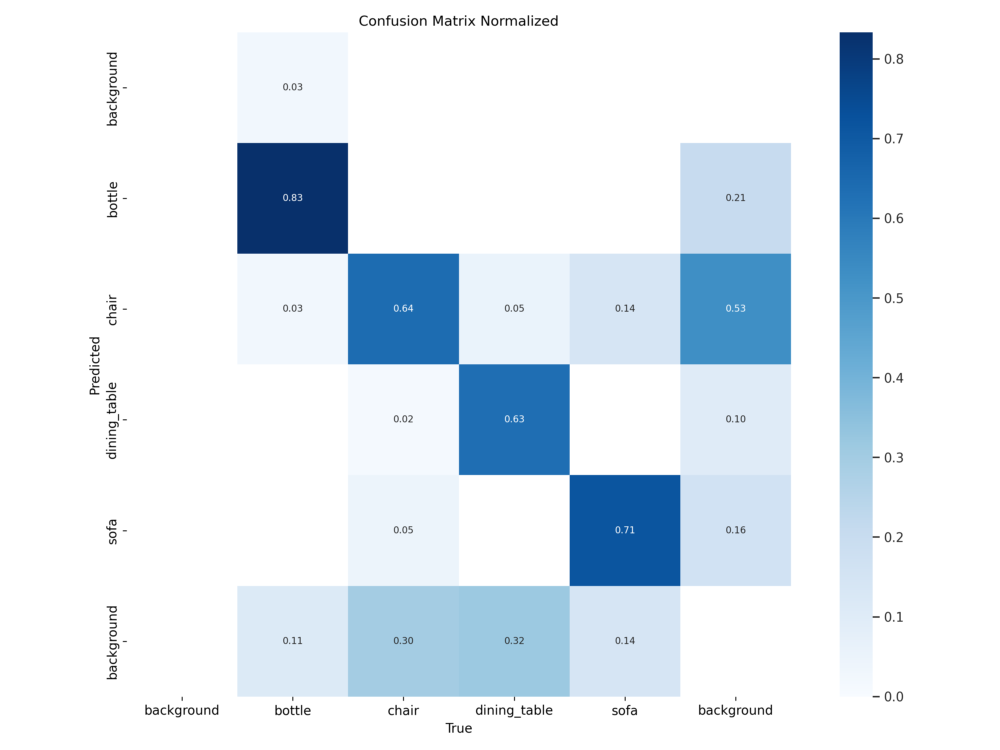

In [29]:
Image(filename = model_path +'confusion_matrix_normalized.png', width=800)

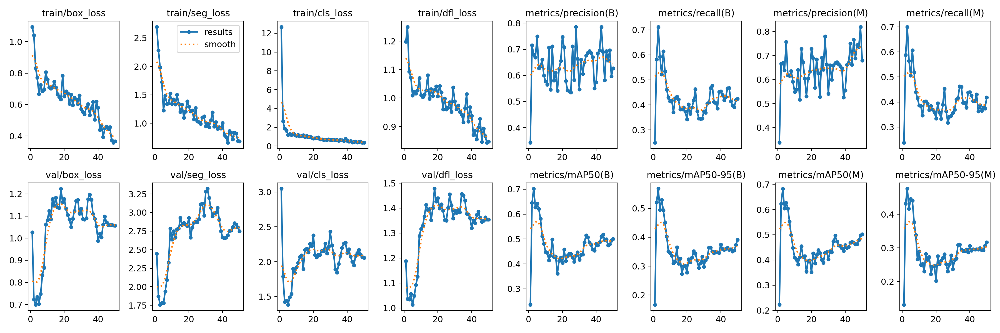

In [32]:
Image(filename = model_path +'results.png', width=1000)

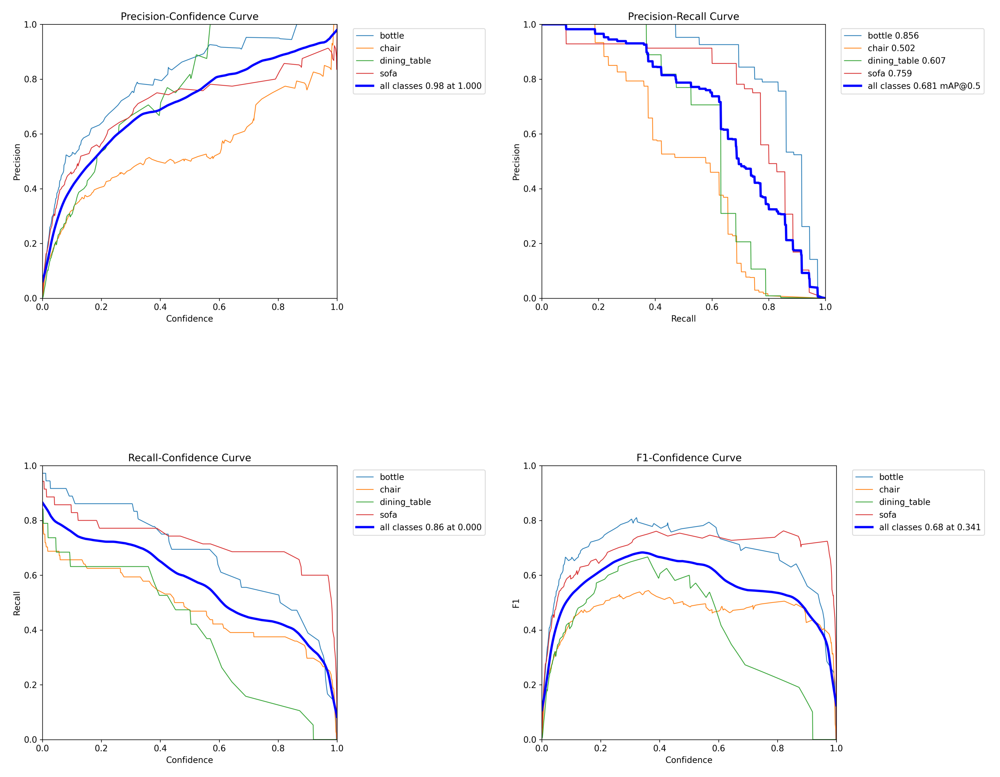

In [33]:
# Define the paths to your images
image_paths = [
    model_path + 'MaskP_curve.png',
    model_path + 'MaskPR_curve.png',
    model_path + 'MaskR_curve.png',
    model_path + 'MaskF1_curve.png'
]

# Set up the figure and axes
fig, axs = plt.subplots(2, 2, figsize=(30, 30))

# Remove axes for a cleaner look
for ax in axs.flatten():
    ax.axis('off')

# Display each image in a 2x2 grid
for ax, img_path in zip(axs.flatten(), image_paths):
    img = plt.imread(img_path)
    ax.imshow(img)

# Display the plot
plt.tight_layout()
plt.show()


### 4. Save the results

In [35]:
from ultralytics import YOLO

# Load the YOLOv8 model configuration
best_model = model_path + "weights/best.pt"
model = YOLO(best_model)  

# Train the model using the configuration file
model.predict(source="./myVOC4/test/images", conf=0.25, save=True)


image 1/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_000573.jpg: 448x640 1 dining_table, 30.7ms
image 2/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_000589.jpg: 448x640 1 dining_table, 4 sofas, 37.3ms
image 3/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_000731.jpg: 640x512 (no detections), 30.9ms
image 4/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_000795.jpg: 448x640 1 bottle, 37.4ms
image 5/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_002521.jpg: 480x640 4 chairs, 30.6ms
image 6/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_002864.jpg: 480x640 3 bottles, 1 chair, 1 dining_table, 29.0ms
image 7/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_004339.jpg: 448x640 (no detections), 30.1ms
image 8/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_004659.jpg: 640x544 1 bottle, 31.9ms
image 9/68 /export/gts_usuarios/assalgado/CV/myVOC4/test/images/2008_005399.jpg: 640x544 1

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: ultralytics.engine.results.Masks object
 names: {0: 'background', 1: 'bottle', 2: 'chair', 3: 'dining_table', 4: 'sofa'}
 obb: None
 orig_img: array([[[ 25,  59,  88],
         [ 42,  58,  87],
         [ 73,  88, 114],
         ...,
         [ 74, 111, 169],
         [ 74, 111, 167],
         [ 73, 110, 166]],
 
        [[ 14,  45,  76],
         [ 51,  62,  94],
         [ 70,  83, 109],
         ...,
         [ 72, 114, 173],
         [ 73, 115, 174],
         [ 74, 117, 174]],
 
        [[  6,  40,  70],
         [ 43,  58,  90],
         [ 67,  82, 108],
         ...,
         [ 79, 123, 184],
         [ 80, 124, 185],
         [ 80, 124, 185]],
 
        ...,
 
        [[ 41,  45,  56],
         [ 42,  46,  57],
         [ 42,  47,  56],
         ...,
         [  1,   4,   8],
         [  1,   4,   8],
         [  0,   3,   7]],
 
        [[ 40,  

### 5. Visualize the results
After using the model to predict over the test dataset, we can find all the images in ``./runs/segment/predict``.   
Below, we print a combination of these test images.

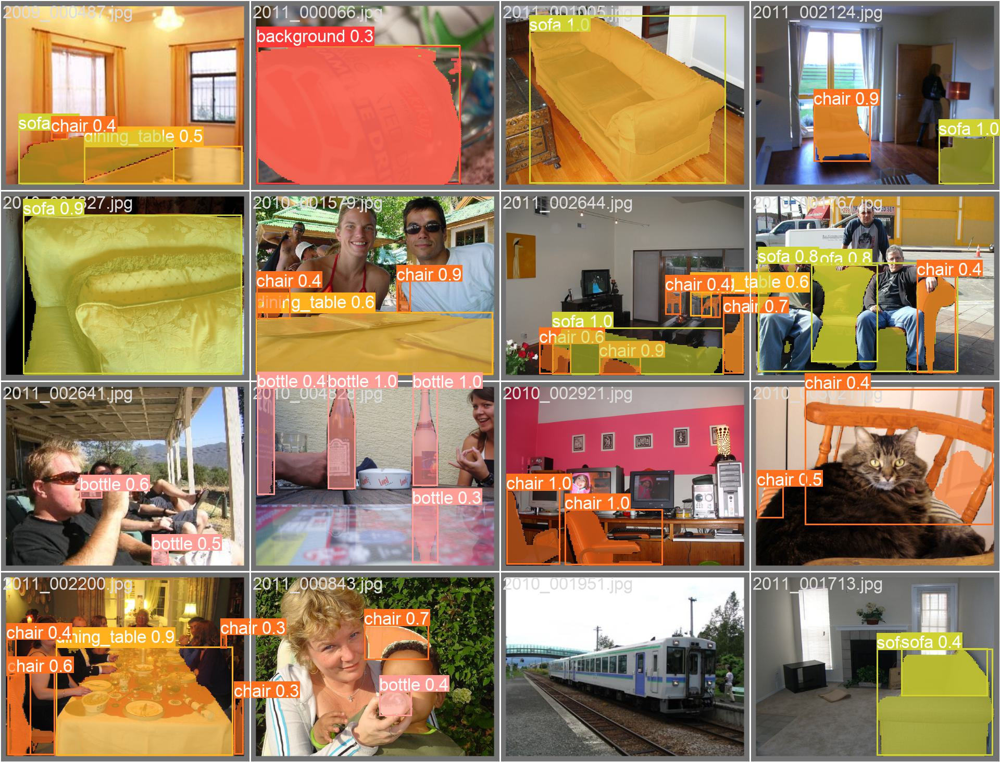

In [36]:
Image(filename = model_path + 'val_batch1_pred.jpg', width=1000)

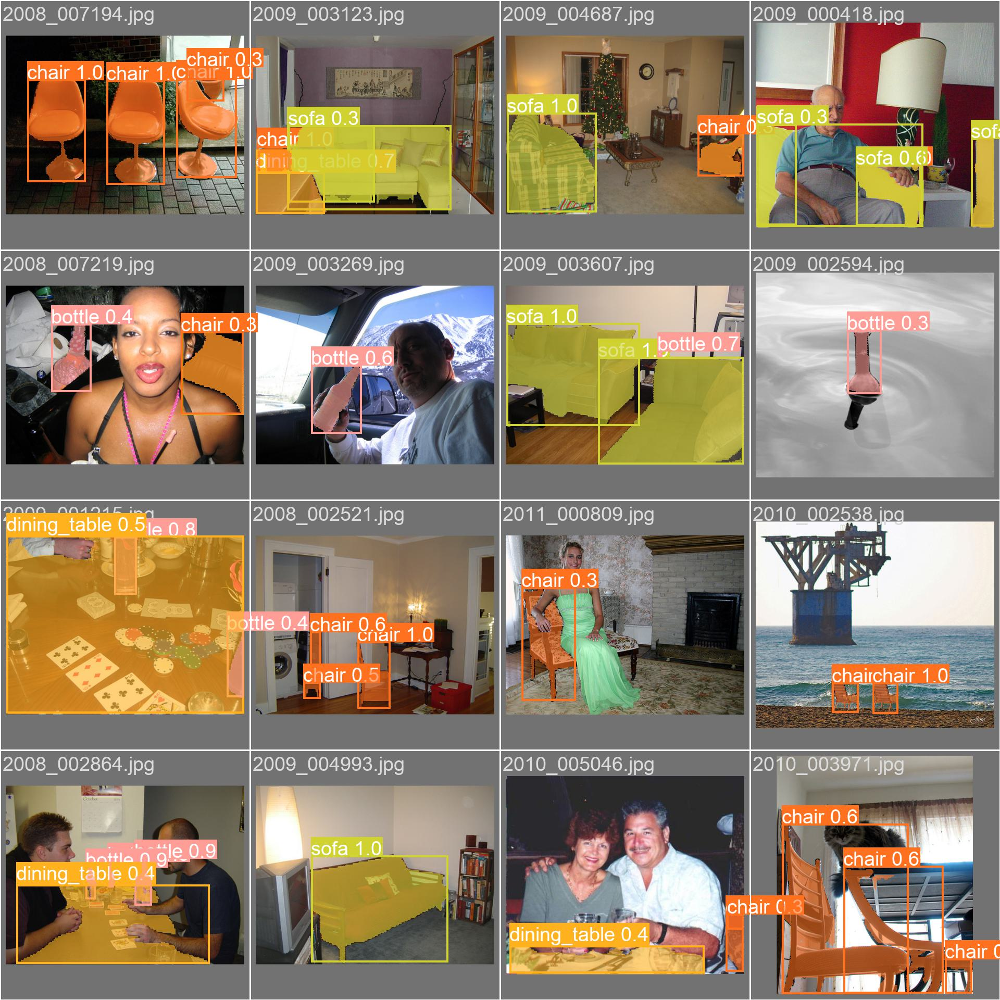

In [37]:
Image(filename = model_path + 'val_batch2_pred.jpg', width=1000)

### 6. Inference with "micasa images"

In [49]:
from ultralytics import YOLO

# Load the YOLOv8 model configuration
model_path = "./runs/segment/seg-SGDe50/"
best_model = model_path + "weights/best.pt"
model = YOLO(best_model)  

# Train the model using the configuration file
model.predict(source="./micasa_img", conf=0.25, save=True)


image 1/3 /export/gts_usuarios/assalgado/CV/micasa_img/IMG_6156.jpg: 480x640 2 bottles, 3 sofas, 32.3ms
image 2/3 /export/gts_usuarios/assalgado/CV/micasa_img/IMG_6157.jpg: 480x640 2 bottles, 3 dining_tables, 4 sofas, 30.7ms
image 3/3 /export/gts_usuarios/assalgado/CV/micasa_img/IMG_6158.jpg: 640x480 1 bottle, 2 chairs, 1 dining_table, 5 sofas, 32.0ms
Speed: 4.3ms preprocess, 31.7ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 480)
Results saved to runs/segment/predict2


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: ultralytics.engine.results.Masks object
 names: {0: 'background', 1: 'bottle', 2: 'chair', 3: 'dining_table', 4: 'sofa'}
 obb: None
 orig_img: array([[[142, 173, 198],
         [139, 170, 195],
         [143, 174, 199],
         ...,
         [154, 180, 192],
         [154, 180, 192],
         [154, 180, 192]],
 
        [[148, 179, 204],
         [148, 179, 204],
         [142, 173, 198],
         ...,
         [157, 183, 195],
         [157, 183, 195],
         [152, 178, 190]],
 
        [[142, 173, 198],
         [146, 177, 202],
         [137, 168, 193],
         ...,
         [150, 176, 188],
         [150, 176, 188],
         [149, 175, 187]],
 
        ...,
 
        [[ 26,  44,  61],
         [ 15,  33,  50],
         [ 13,  31,  48],
         ...,
         [110, 136, 148],
         [114, 140, 152],
         [116, 142, 154]],
 
        [[ 13,  

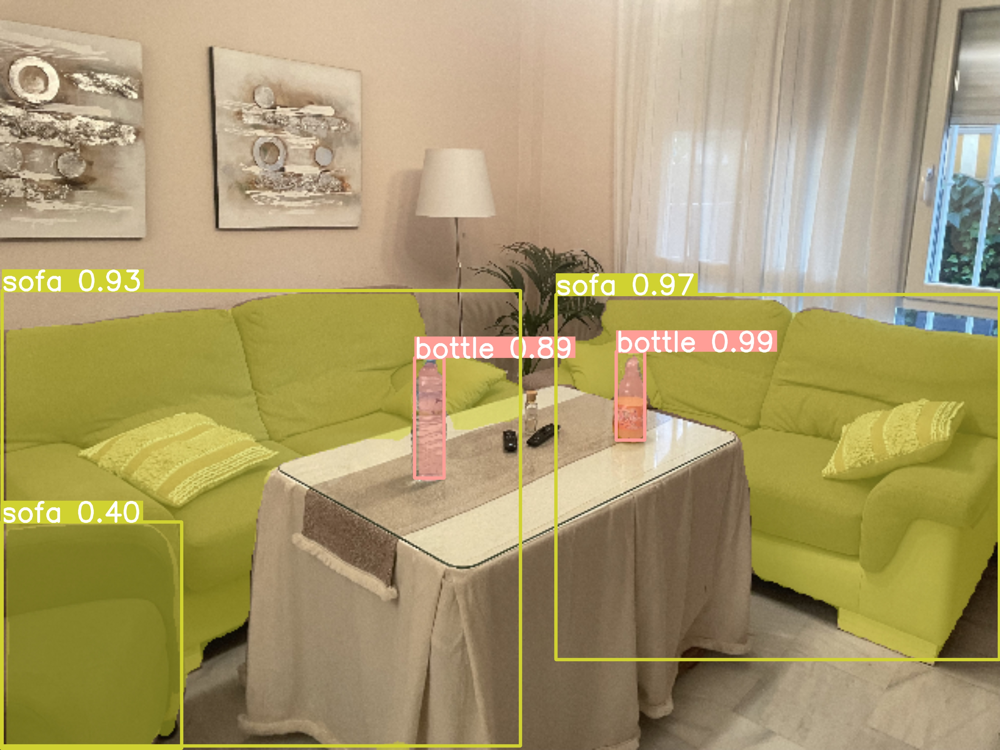

In [55]:
Image(filename='./runs/segment/micasa_predict/IMG_6156.jpg', width=500)

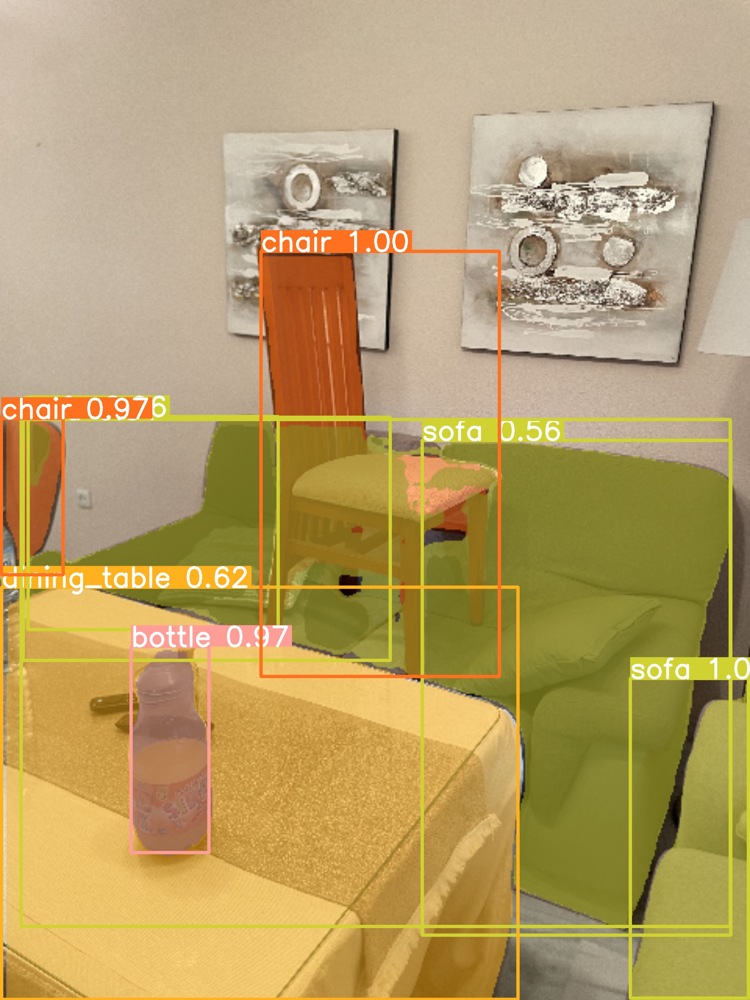

In [56]:
Image(filename='./runs/segment/micasa_predict/IMG_6158.jpg', width=500)